In [1]:
# Import all modules; make sure notebook can be run
import numpy as np
import cv2
import pickle
import os
import matplotlib.pyplot as plt
from moviepy.editor import VideoFileClip
from IPython.display import HTML
%matplotlib inline 

#### Camera Calibration ####
** 1. Briefly state how you computed the camera matrix and distortion coefficients. Provide an example of a distortion corrected calibration image. **

I have used the code from the udacity lessons along with the chessboard images provided. First I start by preparing "object points", which will be the (x, y, z) coordinates of the chessboard corners in the world. Here I am assuming the   chessboard is fixed on the (x, y) plane at z=0, such that the object points are the same for each calibration image.  Thus, `objp` is just a   replicated array of coordinates, and `objpoints` will be appended with a copy of it every time I successfully detect all chessboard corners in a test image.  `imgpoints` will be appended with the (x, y) pixel position of each of the corners in the image plane with each successful      chessboard detection.

I then used the output `objpoints` and `imgpoints` to compute the camera calibration and distortion coefficients using the `cv2.calibrateCamera()` function.  I applied this distortion correction to the test image using the `cv2.undistort()` function and obtained the results shown in the cell below.

In [2]:
cal_images = os.popen("ls camera_cal/cal*.jpg").read().strip().split("\n")
nx=9
ny=6
# Preparing object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((nx * ny, 3), np.float32)
objp[:, :2] = np.mgrid[0:nx, 0:ny].T.reshape(-1, 2)
objpoints = []
imgpoints = []

fig = plt.figure(figsize=(25,20))
for i, c in enumerate(cal_images):
    img = cv2.imread(cal_images[i])
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)

    # If found, draw corners
    ax = fig.add_subplot(5,4,i+1)
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)
            
        # Draw and display the corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        plt.imshow(img);
        plt.axis('off')
        plt.title(c, fontsize=20)
    else:
        plt.imshow(img);
        plt.axis('off')
        plt.title(c, fontsize=20)

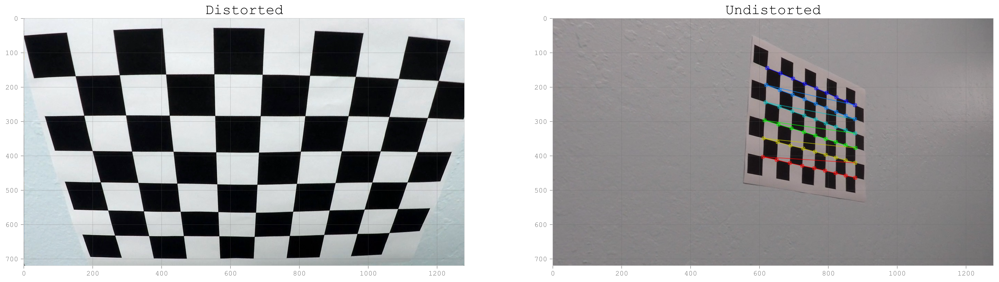

In [5]:
# Test undistortion on a chessboard image
# Using the previously calculated objpoints and imagepoints
def undistort_image(image, mtx, dist):
    return cv2.undistort(img, mtx, dist, None, mtx)

"""
cal_images = os.popen("ls camera_cal/cal*.jpg").read().strip().split("\n")
for i, c in enumerate(cal_images):
    img = cv2.imread(c)
    img_size = (img.shape[1], img.shape[0])
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
    result = undistort_image(img, mtx, dist)
    cv2.imwrite('output_images/chessbord_undistort'+str(i)+'.jpg', result)
"""

# Plot the result for one of the images
input_img = cv2.imread('camera_cal/calibration2.jpg')
img_size = (input_img.shape[1], input_img.shape[0])
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)
result = undistort_image(input_img, mtx, dist)

fig = plt.figure(figsize=(24, 9))
fig.add_subplot(1,2,1)
plt.imshow(input_img);
plt.title('Distorted', fontsize=20)
fig.add_subplot(1,2,2)
plt.imshow(result);
plt.title('Undistorted', fontsize=20);


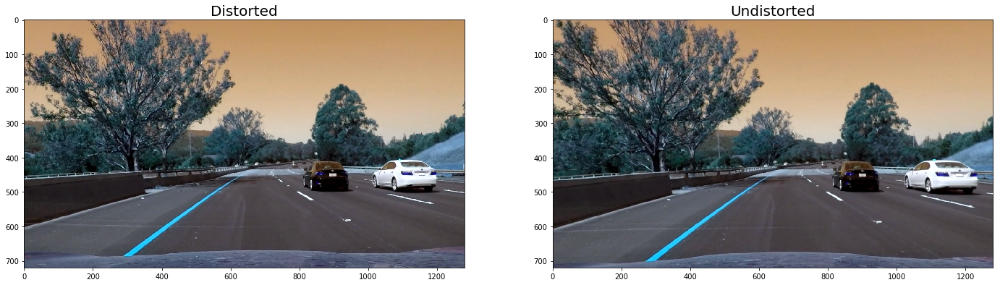

In [17]:
# Test undistortion on a road image
idx=0
test_images = os.popen("ls test_images/test*.jpg").read().strip().split("\n")
for i, c in enumerate(test_images):
    img = cv2.imread(c)
    undistort_img = cv2.undistort(img, mtx, dist, None, mtx)
    cv2.imwrite('output_images/Undistorted_res'+str(idx)+'.jpg', undistort_img)

img = cv2.imread("test_images/test6.jpg")
undistort_img = cv2.undistort(img, mtx, dist, None, mtx)
# Plot the result
fig = plt.figure(figsize=(24, 9))
fig.add_subplot(1,2,1)
plt.imshow(img);
plt.title('Distorted', fontsize=20)
fig.add_subplot(1,2,2)
plt.imshow(undistort_img);
plt.title('Undistorted', fontsize=20);

The undistroted chess and test road images are saved in the output_images folder. 

In [19]:
# function for sobel x or sobel y gradient.
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)   
    if orient == 'x':
        sobel_r = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    elif orient == 'y':
        sobel_r = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel) 
        
    abs_sobel = np.absolute(sobel_r)
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    return sxbinary

# function for overall magnitude of gradient
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel)
    abs_sobel = np.sqrt(np.square(sobelx) + np.square(sobely))
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    
    return sxbinary
# function for color gradient
def hls_select(img, thresh=(0, 255)):
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    S = hsv[:,:,2]   
    binary = np.zeros_like(S)
    binary[(S > thresh[0]) & (S <= thresh[1])] = 1
    
    return binary

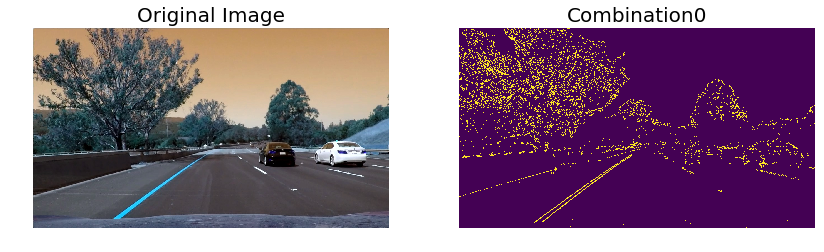

In [20]:
#dist_pickle = pickle.load( open( "camera_calib.p", "rb" ) )
#mtx = dist_pickle["mtx"]
#dist = dist_pickle["dist"]

img = cv2.imread('test_images/test6.jpg')
undistort_img = cv2.undistort(img, mtx, dist, None, mtx)

ksize = 15 

# Apply each of the thresholding functions
gradx = abs_sobel_thresh(undistort_img, orient='x', sobel_kernel=ksize, thresh=(20, 100))
grady = abs_sobel_thresh(undistort_img, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(undistort_img, sobel_kernel=ksize, mag_thresh=(120, 160))

combined = np.zeros_like(mag_binary)
combined[((gradx == 1) & (grady == 1)) | (mag_binary == 1)] = 1

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');
plt.title('Original Image', fontsize=20);
ax = fig.add_subplot(1,2,2)
plt.imshow(combined);
plt.axis('off');
plt.title('Combination0', fontsize=20);

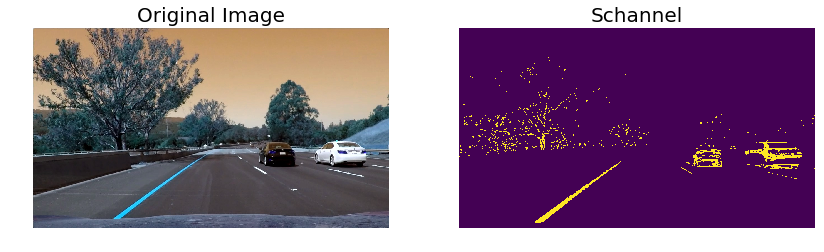

In [21]:
hls_binary = hls_select(undistort_img, thresh=(150, 255))

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');
plt.title('Original Image', fontsize=20);
ax = fig.add_subplot(1,2,2)
plt.imshow(hls_binary);
plt.axis('off');
plt.title('Schannel', fontsize=20);

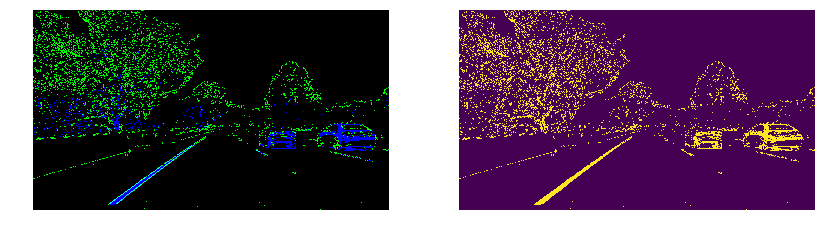

In [22]:
color_binary = np.dstack(( np.zeros_like(combined), combined, hls_binary))

# Combine the two binary thresholds
combined_binary = np.zeros_like(hls_binary)
combined_binary[(combined == 1) | (hls_binary == 1)] = 1

# Plotting thresholded images
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(color_binary);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(combined_binary);
plt.axis('off');


In [23]:
def pipeline(img, M):
    
    img_size = (img.shape[1], img.shape[0])
    
    sobel_kernel = 15
    thresh_min_sobel = 30
    thresh_max_sobel = 100
    
    mag_thresh_min = 120
    mag_thresh_max = 160
    
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undst, cv2.COLOR_BGR2GRAY)
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= thresh_min_sobel) & (scaled_sobelx <= thresh_max_sobel)] = 1
    
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel) 
    abs_sobely = np.absolute(sobely)
    scaled_sobely = np.uint8(255*abs_sobely/np.max(abs_sobely))
    sybinary = np.zeros_like(scaled_sobely)
    sybinary[(scaled_sobely >= thresh_min_sobel) & (scaled_sobely <= thresh_max_sobel)] = 1
    
    abs_sobelxy = np.sqrt(np.square(sobelx) + np.square(sobely))    
    scaled_sobelxy = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))    
    sxybinary = np.zeros_like(scaled_sobelxy)
    sxybinary[(scaled_sobelxy >= mag_thresh_min) & (scaled_sobelxy <= mag_thresh_max)] = 1
    
    grad_combined = np.zeros_like(sxybinary)
    grad_combined[((sxbinary == 1) & (sybinary == 1)) | (sxybinary == 1)] = 1
    
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    S = hsv[:,:,2]   
    binary = np.zeros_like(S)
    binary[(S > 150) & (S <= 255)] = 1
    
    combined_binary = np.zeros_like(binary)
    combined_binary[(grad_combined == 1) | (binary == 1)] = 1
    #combined_binary = np.dstack(( np.zeros_like(binary), grad_combined, binary))
     
    
    Mask_Img = np.zeros_like(combined_binary)   
    ignore_mask_color = 1   
    # This time we are defining a four sided polygon to mask
    imshape = img.shape

    vertices = np.array([[(180,imshape[0]),(610,440), (690,440), (1200,imshape[0])]], dtype=np.int)
    
    cv2.fillPoly(Mask_Img, vertices, ignore_mask_color)
    
    #masked = cv2.bitwise_and(combined_binary, Mask_Img)
    masked = np.zeros_like(Mask_Img)
    masked[(combined_binary == 1) & (Mask_Img == 1)] = 1
    
    w = cv2.warpPerspective(masked, M, img_size)
    
    #w = cv2.warpPerspective(combined_binary, M, img_size)
    
    return w
# Code Source: Lessons

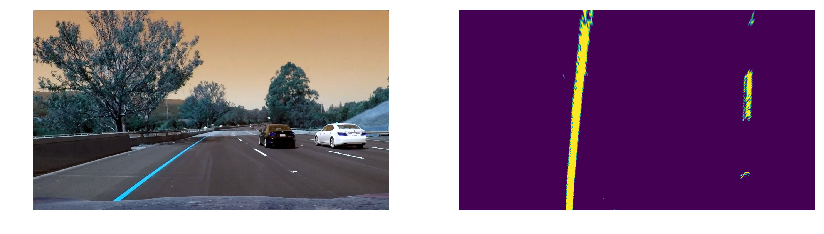

In [25]:
# Test undistortion on an image
img = cv2.imread('test_images/test6.jpg')

src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
dst = np.float32([[350,0],[980,0],[980,720],[350,720]])

#src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
#dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst) 
Minv = cv2.getPerspectiveTransform(dst, src)

result = pipeline(img, M)

# Plot the result
fig=plt.figure(figsize=(14,5))
ax = fig.add_subplot(1,2,1)
plt.imshow(img);
plt.axis('off');

ax = fig.add_subplot(1,2,2)
plt.imshow(result);
plt.axis('off');

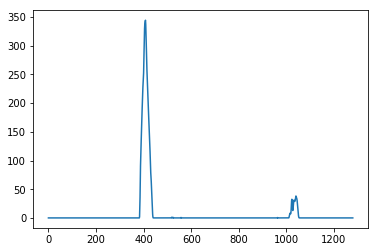

In [27]:
histogram = np.sum(result[360:,:], axis=0)
plt.plot(histogram);
# Code Source: Lessons

In [28]:
# Create an output image to draw on and  visualize the result
out_img = np.dstack((result, result, result))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines

midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(result.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = result.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = result.shape[0] - (window+1)*window_height
    win_y_high = result.shape[0] - window*window_height
    
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

# Generate x and y values for plotting
ploty = np.linspace(0, result.shape[0]-1, result.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
# Code Source: Lessons

##### Now, we have fit a second order polynomial on our left and right lane lines & we can simple visualise how our lines look.

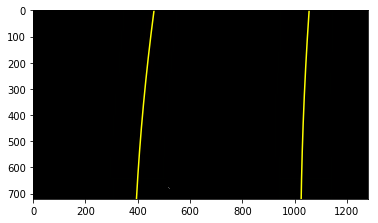

In [31]:
# Generate x and y values for plotting
ploty = np.linspace(0, result.shape[0]-1, result.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0);

In [32]:
y_eval = np.mean(ploty)
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

# Fit new polynomials to x,y in world space
left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
# Calculate the new radii of curvature
left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm')


3100.70083551 m 4528.6089387 m


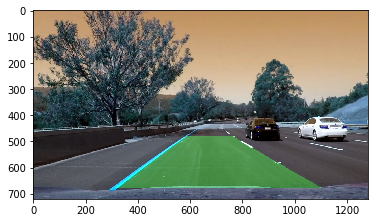

In [33]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(result).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
# Combine the result with the original image
fresult = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
plt.imshow(fresult);

In [41]:
def pipeline(img):
    
    img_size = (img.shape[1], img.shape[0])
    
    sobel_kernel = 15
    thresh_min_sobel = 30
    thresh_max_sobel = 100
    
    mag_thresh_min = 120
    mag_thresh_max = 160
    
    undst = cv2.undistort(img, mtx, dist, None, mtx)
    gray = cv2.cvtColor(undst, cv2.COLOR_BGR2GRAY)
    
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, sobel_kernel)
    abs_sobelx = np.absolute(sobelx)
    scaled_sobelx = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    sxbinary = np.zeros_like(scaled_sobelx)
    sxbinary[(scaled_sobelx >= thresh_min_sobel) & (scaled_sobelx <= thresh_max_sobel)] = 1
    
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, sobel_kernel) 
    abs_sobely = np.absolute(sobely)
    scaled_sobely = np.uint8(255*abs_sobely/np.max(abs_sobely))
    sybinary = np.zeros_like(scaled_sobely)
    sybinary[(scaled_sobely >= thresh_min_sobel) & (scaled_sobely <= thresh_max_sobel)] = 1
    
    abs_sobelxy = np.sqrt(np.square(sobelx) + np.square(sobely))    
    scaled_sobelxy = np.uint8(255*abs_sobelxy/np.max(abs_sobelxy))    
    sxybinary = np.zeros_like(scaled_sobelxy)
    sxybinary[(scaled_sobelxy >= mag_thresh_min) & (scaled_sobelxy <= mag_thresh_max)] = 1
    
    grad_combined = np.zeros_like(sxybinary)
    grad_combined[((sxbinary == 1) & (sybinary == 1)) | (sxybinary == 1)] = 1
    
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HLS).astype(np.float)
    S = hsv[:,:,2]   
    binary = np.zeros_like(S)
    binary[(S > 150) & (S <= 255)] = 1
    
    combined_binary = np.zeros_like(binary)
    combined_binary[(grad_combined == 1) | (binary == 1)] = 1
    
    # Region Masking    
    Mask_Img = np.zeros_like(combined_binary)    
    # This time we are defining a four sided polygon to mask
    imshape = img.shape
    vertices = np.array([[(180,imshape[0]),(610,440), 
                          (690,440), (1200,imshape[0])]], dtype=np.int)    
    cv2.fillPoly(Mask_Img, vertices, 1)  
    masked = np.zeros_like(Mask_Img)
    masked[(combined_binary == 1) & (Mask_Img == 1)] = 1
    
    w = cv2.warpPerspective(masked, M, img_size)
    
    histogram = np.sum(w[360:,:], axis=0)
    
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(w.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = w.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = w.shape[0] - (window+1)*window_height
        win_y_high = w.shape[0] - window*window_height
    
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
    
         # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
    
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, w.shape[0]-1, w.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero = np.zeros_like(w).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))   

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    fresult = cv2.addWeighted(img, 1, newwarp, 0.3, 0)    
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    y_eval = np.mean(ploty)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + 
                           left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + 
                            right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    # Now our radius of curvature is in meters

    a="Curvature left: " + str(left_curverad) + " right: " + str(right_curverad)
    cv2.putText(fresult,a,(400,50), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,0,0),2)
  
    # Road position of vehicle
    xm_per_pix = 3.7/700
    left_lane_pos = left_fitx[len(left_fitx)-1]
    right_lane_pos = right_fitx[len(right_fitx)-1]
    road_pos = (((left_lane_pos + right_lane_pos) / 2) - 640) * xm_per_pix
    b="Road offset: " + str(road_pos)
    cv2.putText(fresult,b,(700,90), cv2.FONT_HERSHEY_SIMPLEX, 1,(0,0,0),2)
    
    return fresult

In [42]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("project_video.mp4")
annotated_video = "project_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))


[MoviePy] >>>> Building video project_video_out.mp4
[MoviePy] Writing video project_video_out.mp4



100%|█████████▉| 1260/1261 [04:48<00:00,  4.70it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_out.mp4 

CPU times: user 4min 4s, sys: 1min 10s, total: 5min 14s
Wall time: 4min 49s


In [ ]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("challenge_video.mp4")
annotated_video = "challenge_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))

In [ ]:
#src = np.float32([[550,480],[740,480],[1050,680],[250,680]])     
#dst = np.float32([[350,0],[980,0],[980,720],[350,720]])
src = np.float32([[620,450],[680,450],[1050,680],[250,680]])   
dst = np.float32([[590,0],[860,0],[900,720],[450,720]])
        
M = cv2.getPerspectiveTransform(src, dst)
Minv = cv2.getPerspectiveTransform(dst, src)     

test_video = VideoFileClip("harder_challenge_video.mp4")
annotated_video = "harder_challenge_video_out.mp4"

test_output = test_video.fl_image(pipeline);
%time test_output.write_videofile(annotated_video, audio=False)

# Display output video
HTML("""
<video width="600" height="320" controls>
  <source src="{0}">
</video>
""".format(annotated_video))